# Image Retrieval Systems and Clustering

In [95]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd

## Connect to Database 

In [96]:
import psycopg2
def get_images_fromDB():
    try:
        connection = psycopg2.connect(user="postgres",password="postgres",host="127.0.0.1",port="5432",database="images")
        cursor = connection.cursor()
        postgreSQL = "select id,filepath,filename,keywords from image"
        cursor.execute(postgreSQL)
        records = cursor.fetchall()
        df = pd.DataFrame(columns=["id", "filepath", "filename","keywords"])
        row_list = []
        for row in records:
            row_list.append([row[0], row[1], row[2], row[3]])
        df=pd.DataFrame(row_list,columns=["id", "filepath", "filename","keywords"])
    finally: 
        if(connection):
            cursor.close()
            connection.close()
        print("PostgreSQL connection is closed")
    return df
df = get_images_fromDB()
df

PostgreSQL connection is closed


,id,filepath,filename,keywords
0,0,C:/Users/GNR/Desktop/Project_Comp_Geometry,carton.png,"flat, carton, object, sail, brown"
1,1,C:/Users/GNR/Desktop/Project_Comp_Geometry,flatearth.png,"earth, flat, blue, green, real, not, true"
2,2,C:/Users/GNR/Desktop/Project_Comp_Geometry,flat01.png,"apartment, furniture, home, flat"
3,3,C:/Users/GNR/Downloads,google.png,"google, flat, image"
4,4,C:/Users/GNR/Downloads,red.png,"red, flat, object"
5,5,C:/Users/GNR/Downloads,priorities-landing-page.png,"flat, leaf, green"
6,6,C:/Users/GNR/Downloads,flats.png,"flats, shoes,black"


In [97]:
class Dataset:
    def __init__(self,filename,feature_vector):
        self.filename = filename
        self.feature_vector = feature_vector
        self.dim = len(feature_vector)
    def printObject(self):
        print("Image Name: ",self.filename)
        print("Feature vector: ")
        print(self.feature_vector)
    def updatedDataset(self,true_dimension):
        if self.dim < true_dimension :
            arr = np.zeros(true_dimension - self.dim)
            vector = np.append(self.feature_vector,arr)
            self.feature_vector = vector
            self.dim = len(vector)
    def clusterGroup(self,group):
        self.group = group
        
list_filenames = df["filename"].tolist()
list_filepaths = df["filepath"].tolist()

def create_paths(list_filenames, list_filepaths):
    paths = []
    for i in range(0,len(list_filenames)):
        paths.append(list_filepaths[i] + "/" + list_filenames[i])
    return paths
               
dataset_points = []
paths = create_paths(list_filenames, list_filepaths)
for path in paths:
    print(path)

C:/Users/GNR/Desktop/Project_Comp_Geometry/carton.png
C:/Users/GNR/Desktop/Project_Comp_Geometry/flatearth.png
C:/Users/GNR/Desktop/Project_Comp_Geometry/flat01.png
C:/Users/GNR/Downloads/google.png
C:/Users/GNR/Downloads/red.png
C:/Users/GNR/Downloads/priorities-landing-page.png
C:/Users/GNR/Downloads/flats.png


## OpenCV 
Shape returns (Height, Width, Number of Channels)
1.	Height represents the number of pixel rows in the image or the number of pixels in each column of the image array.
2.	Width represents the number of pixel columns in the image or the number of pixels in each row of the image array.
3.	Number of Channels represents the number of components used to represent each pixel.


(300, 640, 3)

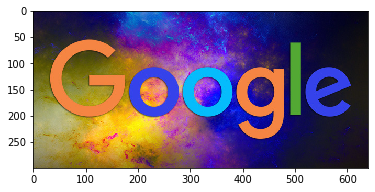

In [98]:
image = cv2.imread("google.png")
plt.imshow(image)
image.shape

(300, 640, 3)

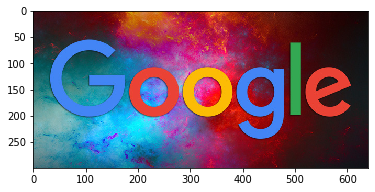

In [99]:
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
plt.imshow(image)
image.shape

(300, 640)

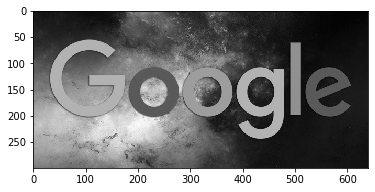

In [100]:
import matplotlib.cm as cm
image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
plt.imshow(image,cmap=cm.gray)
image.shape

## Flatten Image

Shape Before: (1200, 1600, 3)
Shape After:  (1200, 4800)


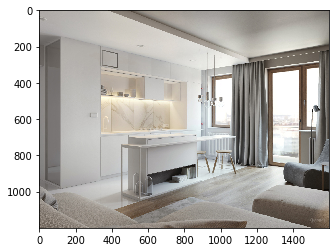

In [101]:
image = cv2.imread(paths[2])
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
plt.imshow(image)
print("Shape Before:",image.shape)
def flatten_image(image):
    shaped = image.shape
    im = []
    for i in range(0,shaped[0]):
        img = image[i].flatten()
        im.append(img)
    im = np.array(im)
    return im
example_image = flatten_image(image)
print("Shape After: ",example_image.shape)

## Clustering based on pixel intensity [Raw Pixel Feature Vectors]
What image descriptor are we going to use? Raw pixel descriptor. We expect the output of descriptors to be a list of numbers corresponding to the raw RGB pixel intensities of image.

In [102]:
def image_feature_extraction(path):
    image = cv2.imread(path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    processed_image = flatten_image(image)
    return processed_image

## Principal Component Analysis
Principal Component Analysis (PCA) is a linear dimensionality reduction technique that can be utilized for extracting information from a high-dimensional space by projecting it into a lower-dimensional sub-space. It tries to preserve the essential parts that have more variation of the data and remove the non-essential parts with fewer variation. A property of PCA is that you can choose the number of dimensions or principal components in the transformed result.

In [103]:
from sklearn.decomposition import PCA
image = image_feature_extraction(paths[3])
X = image[:,0:len(image)]
Y = image[:,len(image)]
print("Image Shape Before: ",image.shape)
pca = PCA(n_components=3)
fit = pca.fit(X)
print("Shape after PCA: ",fit.components_.shape)
fit.components_

Image Shape Before:  (300, 1920)
Shape after PCA:  (3, 300)


array([[-2.85162353e-02, -6.43274111e-02, -6.03041195e-02,
        -2.85340987e-02, -6.47895551e-02, -6.08952356e-02,
        -2.86420191e-02, -6.49888377e-02, -6.14720186e-02,
        -2.80950730e-02, -6.46562308e-02, -6.16872403e-02,
        -2.69346063e-02, -6.52076777e-02, -6.20218882e-02,
        -2.61817819e-02, -6.54829713e-02, -6.22237537e-02,
        -2.68079828e-02, -6.58179559e-02, -6.25888018e-02,
        -2.76019228e-02, -6.67823096e-02, -6.32319079e-02,
        -2.78170257e-02, -6.71432166e-02, -6.46154170e-02,
        -2.74902127e-02, -6.74920064e-02, -6.50619428e-02,
        -2.68559650e-02, -6.74181003e-02, -6.51594352e-02,
        -2.60947152e-02, -6.67574504e-02, -6.46746117e-02,
        -2.60842194e-02, -6.68773205e-02, -6.47680447e-02,
        -2.64206878e-02, -6.72477653e-02, -6.48819738e-02,
        -2.64762821e-02, -6.71439855e-02, -6.47789637e-02,
        -2.70687559e-02, -6.74822757e-02, -6.53328064e-02,
        -2.60220397e-02, -6.77478288e-02, -6.58340038e-0

In [104]:
def Pca(image):
    X = image[:,0:len(image)]
    Y = image[:,len(image)]
    pca = PCA(n_components=1)
    fit = pca.fit(X)
    return fit.components_

The sign (positive or negative) tells us the direction that a given variable in that PCA is going on a single dimension vector.

In [105]:
#flatten again, in order to get a vector
def shape_features(image):
    features = image.ravel()
    print("Features Shape: ", features.shape)
    return features

dataset_points = []

for image in paths:
    photo = image_feature_extraction(image)
    matrix = Pca(photo)
    features = shape_features(matrix)
    temp_object = Dataset(image,features)
    temp_object.printObject()
    dataset_points.append(temp_object)

Features Shape:  (572,)
Image Name:  C:/Users/GNR/Desktop/Project_Comp_Geometry/carton.png
Feature vector: 
[-0.00227085 -0.00328266 -0.00362412 -0.00184477 -0.00324785 -0.00355498
 -0.00188571 -0.00326294 -0.003583   -0.00206617 -0.00341035 -0.00372751
 -0.00214513 -0.00355771 -0.00387487 -0.00234742 -0.00376    -0.00422595
 -0.00235112 -0.00380885 -0.0042748  -0.00246843 -0.00392312 -0.00439206
 -0.0025878  -0.00402956 -0.00449851 -0.00250368 -0.00419736 -0.00471584
 -0.00249577 -0.00418243 -0.00471884 -0.00260971 -0.00417285 -0.00471035
 -0.00272344 -0.00426774 -0.0049608  -0.00297958 -0.00472561 -0.00579698
 -0.00307984 -0.00519809 -0.00683444 -0.00304834 -0.00580652 -0.00811544
 -0.00310865 -0.00627595 -0.00907533 -0.0025201  -0.00675988 -0.01047721
 -0.00292355 -0.00730457 -0.01180447 -0.00301707 -0.00794411 -0.01325956
 -0.00287994 -0.00874708 -0.01438293 -0.00289464 -0.00945049 -0.01578144
 -0.00276259 -0.00976531 -0.01722757 -0.00245118 -0.01018554 -0.01844845
 -0.00238269 -0.

Features Shape:  (1200,)
Image Name:  C:/Users/GNR/Desktop/Project_Comp_Geometry/flat01.png
Feature vector: 
[-0.00907733 -0.01414797 -0.01823706 ... -0.03576065 -0.03609604
 -0.03308031]
Features Shape:  (300,)
Image Name:  C:/Users/GNR/Downloads/google.png
Feature vector: 
[-0.02851624 -0.06432741 -0.06030412 -0.0285341  -0.06478956 -0.06089524
 -0.02864202 -0.06498884 -0.06147202 -0.02809507 -0.06465623 -0.06168724
 -0.02693461 -0.06520768 -0.06202189 -0.02618178 -0.06548297 -0.06222375
 -0.02680798 -0.06581796 -0.0625888  -0.02760192 -0.06678231 -0.06323191
 -0.02781703 -0.06714322 -0.06461542 -0.02749021 -0.06749201 -0.06506194
 -0.02685596 -0.0674181  -0.06515944 -0.02609472 -0.06675745 -0.06467461
 -0.02608422 -0.06687732 -0.06476804 -0.02642069 -0.06724777 -0.06488197
 -0.02647628 -0.06714399 -0.06477896 -0.02706876 -0.06748228 -0.06533281
 -0.02602204 -0.06774783 -0.065834   -0.02546648 -0.06774416 -0.06597254
 -0.02453839 -0.06777649 -0.066111   -0.0239473  -0.06790721 -0.066

Features Shape:  (900,)
Image Name:  C:/Users/GNR/Downloads/priorities-landing-page.png
Feature vector: 
[-0.02621244 -0.01924003 -0.03672407 -0.02451529 -0.01799026 -0.03537243
 -0.02432156 -0.01708465 -0.03455199 -0.02274907 -0.01623142 -0.0309368
 -0.02128163 -0.01632024 -0.02684103 -0.01780472 -0.01442282 -0.02149322
 -0.01245722 -0.01109221 -0.01744895 -0.01104757 -0.00980467 -0.01621017
 -0.01010005 -0.01001623 -0.01193336 -0.01496742 -0.01301458 -0.01941237
 -0.01828588 -0.01368096 -0.02525976 -0.0208367  -0.01466811 -0.02841276
 -0.02226039 -0.01649071 -0.02826253 -0.01821249 -0.01437056 -0.02357743
 -0.01604771 -0.01232106 -0.02105528 -0.01658084 -0.01201256 -0.02193509
 -0.01941438 -0.01346818 -0.02520381 -0.02938666 -0.02142276 -0.04010641
 -0.034598   -0.02304655 -0.0515347  -0.0412596  -0.02692833 -0.06174577
 -0.04652054 -0.03180829 -0.06726822 -0.0419629  -0.02748515 -0.059719
 -0.03789545 -0.02552678 -0.05282124 -0.03135311 -0.02071128 -0.04530594
 -0.02216659 -0.015777

Features Shape:  (2000,)
Image Name:  C:/Users/GNR/Downloads/flats.png
Feature vector: 
[-3.44037312e-05 -3.44037312e-05 -3.44037312e-05 ... -2.13815592e-02
 -2.13508290e-02 -2.13508290e-02]


## K-Means implemented from scratch

In [106]:
true_dim = max(node.dim for node in dataset_points) 

In [107]:
for point in dataset_points:
    point.updatedDataset(true_dim)

In [108]:
for updated_point in dataset_points:
    updated_point.printObject()

Image Name:  C:/Users/GNR/Desktop/Project_Comp_Geometry/carton.png
Feature vector: 
[-0.00227085 -0.00328266 -0.00362412 ...  0.          0.
  0.        ]
Image Name:  C:/Users/GNR/Desktop/Project_Comp_Geometry/flatearth.png
Feature vector: 
[-2.43652534e-03 -5.12857051e-05 -8.18061477e-04 ...  0.00000000e+00
  0.00000000e+00  0.00000000e+00]
Image Name:  C:/Users/GNR/Desktop/Project_Comp_Geometry/flat01.png
Feature vector: 
[-0.00907733 -0.01414797 -0.01823706 ...  0.          0.
  0.        ]
Image Name:  C:/Users/GNR/Downloads/google.png
Feature vector: 
[-0.02851624 -0.06432741 -0.06030412 ...  0.          0.
  0.        ]
Image Name:  C:/Users/GNR/Downloads/red.png
Feature vector: 
[3.22560808e-04 1.35901475e-04 9.11651942e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
Image Name:  C:/Users/GNR/Downloads/priorities-landing-page.png
Feature vector: 
[-0.02621244 -0.01924003 -0.03672407 ...  0.          0.
  0.        ]
Image Name:  C:/Users/GNR/Downloads/flats.png
Feature v

In [109]:
#Choose k number of clusters
import random

k = 3
n = random.uniform(-9, 9)
n

-2.7884841942556635

In [110]:
#Select at random K points, the centroids(not necessarily from your dataset).
class Centroids:
    def __init__(self,vector,group):
        self.vector = vector
        self.group = group
    def printObject(self):
        print(self.vector)
        print(self.group)
        
def initial_centroids(k,true_dim):
    centroids = []
    for i in range(0,k):
        centroid =[]
        for n in range(0,true_dim):
            centroid.append(random.uniform(-9,9))
        temp_object = Centroids(centroid,i)
        temp_object.printObject()
        centroids.append(temp_object)
    return centroids
centroids = initial_centroids(k,true_dim)
centroids

[-8.514945858107836, 2.94482118471681, -5.580254304312341, -1.2843963557347173, -1.4837789476725973, 0.439402371296838, 8.936040957763357, 5.724803862840458, 5.717399786366666, -8.324008158290209, 4.887151116267416, 0.1794187223341268, -8.67902498950295, 0.8020521811430843, -2.6758588922116076, 2.2312733800500038, -4.223954285630421, -1.1000862930616906, -0.4897982290718712, 2.149196445581243, 4.427766900214468, 4.724184247600666, 1.2437622287209944, 3.8096313668795805, -8.259903056965083, 8.789092577625205, -3.3860812671277056, -4.809854719308412, -7.363313568273242, 4.649295167334101, 5.27076117499727, 2.2845906441327237, 1.4733264717259047, -2.918068261814187, -1.5252423295479307, -2.978330663885126, -0.7138977358977936, 7.707250533355996, 2.747738572678591, 6.268377811208628, 7.153227750811176, 2.6321542023323, 0.8975904911665165, 4.277852037630913, -3.3459197153794538, 8.423599393097575, 8.044270757205162, 0.7465900869722333, -6.823938615303088, -0.25585499247067744, -3.3410177511

In [111]:
centroids[1].vector

[-6.56563385077053,
 -2.0218736656531213,
 3.551171528129643,
 -1.9272768749439457,
 3.165687177740635,
 1.8919729158706353,
 1.6041229846401777,
 7.1920855209857635,
 -6.03504145345166,
 -0.04284715827092711,
 -2.236367125205015,
 8.121952004304433,
 -1.8796227185638532,
 -3.865789916436552,
 3.729002054089941,
 -0.7165036277495105,
 4.393494046624953,
 1.2521726138374127,
 6.053613259729472,
 4.889643480740384,
 7.490241224131619,
 -5.562456207609243,
 -7.205362111437916,
 -7.972098228579494,
 -1.8448459272588833,
 7.696693126026357,
 0.4826886556537815,
 8.234880824564762,
 -1.7207208719980178,
 4.932096399929328,
 -4.138760012555738,
 -2.076175476967723,
 7.569786616831781,
 3.649769570085926,
 1.0030690817438597,
 -8.285612078291459,
 -8.616609063563287,
 -3.6591615702662086,
 8.06322437329661,
 -2.6373094074632455,
 -0.34689498089641013,
 -4.930009882010949,
 -1.964020727185031,
 -5.776363624345982,
 6.761102905070153,
 3.797359079262389,
 2.183306491870484,
 -3.182077009728319,


## Assignment Step

In [112]:
from scipy.spatial import distance

clusters = []
def search_points_choose_centroids(dataset_points,centroids,k):
    clusters = [ [] for _ in range(k) ]
    for point in dataset_points:
        eu_dis = []
        print(point.filename)
        for c in centroids:
            dst = distance.euclidean(point.feature_vector, c.vector)
            print("For one point distances: ",dst)
            eu_dis.append(dst)
        mindis = min(eu_dis)
        minpos = eu_dis.index(min(eu_dis))
        clusters[minpos].append(point)
    return clusters

In [113]:
clusters = search_points_choose_centroids(dataset_points,centroids,k)
clusters

C:/Users/GNR/Desktop/Project_Comp_Geometry/carton.png
For one point distances:  233.55312515843343
For one point distances:  234.51474577834293
For one point distances:  228.60025258134294
C:/Users/GNR/Desktop/Project_Comp_Geometry/flatearth.png
For one point distances:  233.57456023753866
For one point distances:  234.50990624898813
For one point distances:  228.5559828084316
C:/Users/GNR/Desktop/Project_Comp_Geometry/flat01.png
For one point distances:  233.5993484644661
For one point distances:  234.52609273446544
For one point distances:  228.5845963491703
C:/Users/GNR/Downloads/google.png
For one point distances:  233.5747238450119
For one point distances:  234.52783849171516
For one point distances:  228.59111360616103
C:/Users/GNR/Downloads/red.png
For one point distances:  233.58668862891597
For one point distances:  234.5401385912592
For one point distances:  228.55887198776819
C:/Users/GNR/Downloads/priorities-landing-page.png
For one point distances:  233.57114786931007
For 

[[],
 [],

## Update Step [K-Means]

In [114]:
from __future__ import division

def mean(a):
    c = []
    for i in a:
        c.append(i.feature_vector)
    return sum(c) / len(c)
new_centroids = []
def update(clusters):
    centroids = [ [] for _ in range(len(clusters)) ]
    for c in range(0,len(clusters)):
        if(len(clusters[c])!= 0):
            centroids[c] = mean(clusters[c])
            centroids[c] = centroids[c].tolist()
    return centroids
new_centroids = update(clusters)
new_centroids

[[],
 [],
 [-0.009746461533158576,
  -0.014421123075961887,
  -0.01709295306109549,
  -0.009521610628753896,
  -0.01440048361543354,
  -0.017073854155176187,
  -0.009520586654139952,
  -0.013934556692204031,
  -0.016651152114000752,
  -0.008044896276474615,
  -0.011607640649179142,
  -0.01413763328164723,
  -0.0074469760007181635,
  -0.010552484253332483,
  -0.012486238846720052,
  -0.0074323411996520955,
  -0.01031513074538015,
  -0.011806330930217783,
  -0.007242255633534214,
  -0.010694534931088021,
  -0.011932854693761758,
  -0.007153978547443902,
  -0.010360866495613292,
  -0.011767295710565649,
  -0.0070531818530626105,
  -0.010584604899925066,
  -0.011430030400521023,
  -0.007594322917588626,
  -0.010885766832532204,
  -0.012470820500106755,
  -0.007969817020623158,
  -0.01080906616689435,
  -0.013202449197644517,
  -0.008313551664018728,
  -0.010810052952610161,
  -0.013522612159640504,
  -0.00854595083399064,
  -0.011046756661284117,
  -0.013489366349533946,
  -0.0079359540198

## The Algorithm

In [115]:
def my_kmeans(dataset_points,k,true_dim):
    centroids = initial_centroids(k,true_dim)
    new_clusters = []
    new_centroids = []
    for i in range(0,10):
        if(centroids == new_centroids):
            break
        else:
            new_clusters = search_points_choose_centroids(dataset_points,centroids,k)
            new_centroids = update(clusters)
            centroids = new_centroids
    return new_clusters
final_clusters = my_kmeans(dataset_points,k,true_dim)

[-2.5910645035108644, 1.1827707842302875, 5.636260765880344, -4.896698225557676, 8.321629995420935, 8.017698975121654, 5.850908618596822, 4.3232785908932705, 6.396274184675454, 1.061276073488635, 1.0267338182945718, -8.36365284776159, -8.366849651278008, 8.679968676934266, 3.665013949982967, -0.26865451148775676, -6.581985404050419, 6.682604881176683, 3.538007484062108, 1.9860563044922444, 2.4836290199780144, 4.6718329385259345, 4.933669059720893, -7.743041138184162, 0.3903148613138452, 3.765532741428471, -0.34883232898791583, 1.6095076906696448, 0.24584031040020804, -3.3790085003498485, 1.3015127337987966, -8.337192997370153, -4.799929103225682, -8.137155651271387, -3.0115481137856923, -6.7764659338354525, -7.091118306253158, -3.3872580319579573, -2.1872843929366192, 5.627130750990098, -1.98779202319521, -1.4963021045825506, -1.4570587057906854, -6.68848645118304, -0.3279645946973364, -4.556479317892918, -5.439795762488698, -2.7420078809448603, -1.9736438510678385, -2.4983561117973982

In [116]:
final_clusters

[[],
 [],

## Sklearn K-Means
It uses K-Means++ as an initialization method and that is the reason why we are able to get a better classification here.

In [117]:
type(dataset_points[0].feature_vector)

numpy.ndarray

In [118]:
from sklearn.cluster import KMeans

X = []
for d in dataset_points:
    X.append(d.feature_vector.tolist())
X = np.array(X)
X

array([[-2.27085373e-03, -3.28265871e-03, -3.62411910e-03, ...,
         0.00000000e+00,  0.00000000e+00,  0.00000000e+00],
       [-2.43652534e-03, -5.12857051e-05, -8.18061477e-04, ...,
         0.00000000e+00,  0.00000000e+00,  0.00000000e+00],
       [-9.07733340e-03, -1.41479694e-02, -1.82370639e-02, ...,
         0.00000000e+00,  0.00000000e+00,  0.00000000e+00],
       ...,
       [ 3.22560808e-04,  1.35901475e-04,  9.11651942e-05, ...,
         0.00000000e+00,  0.00000000e+00,  0.00000000e+00],
       [-2.62124401e-02, -1.92400343e-02, -3.67240690e-02, ...,
         0.00000000e+00,  0.00000000e+00,  0.00000000e+00],
       [-3.44037312e-05, -3.44037312e-05, -3.44037312e-05, ...,
        -2.13815592e-02, -2.13508290e-02, -2.13508290e-02]])

In [119]:
kmeans = KMeans(n_clusters=3, random_state=0).fit(X)

In [120]:
kmeans.labels_

array([1, 0, 2, 1, 0, 1, 2])

In [121]:
k_labels = kmeans.labels_.tolist()
for i in range(0,len(dataset_points)):
    dataset_points[i].clusterGroup(k_labels[i])

In [122]:
for d in dataset_points:
    print("Image title: ", d.filename)
    print("Image cluster: ", d.group)

Image title:  C:/Users/GNR/Desktop/Project_Comp_Geometry/carton.png
Image cluster:  1
Image title:  C:/Users/GNR/Desktop/Project_Comp_Geometry/flatearth.png
Image cluster:  0
Image title:  C:/Users/GNR/Desktop/Project_Comp_Geometry/flat01.png
Image cluster:  2
Image title:  C:/Users/GNR/Downloads/google.png
Image cluster:  1
Image title:  C:/Users/GNR/Downloads/red.png
Image cluster:  0
Image title:  C:/Users/GNR/Downloads/priorities-landing-page.png
Image cluster:  1
Image title:  C:/Users/GNR/Downloads/flats.png
Image cluster:  2


Cluster  0


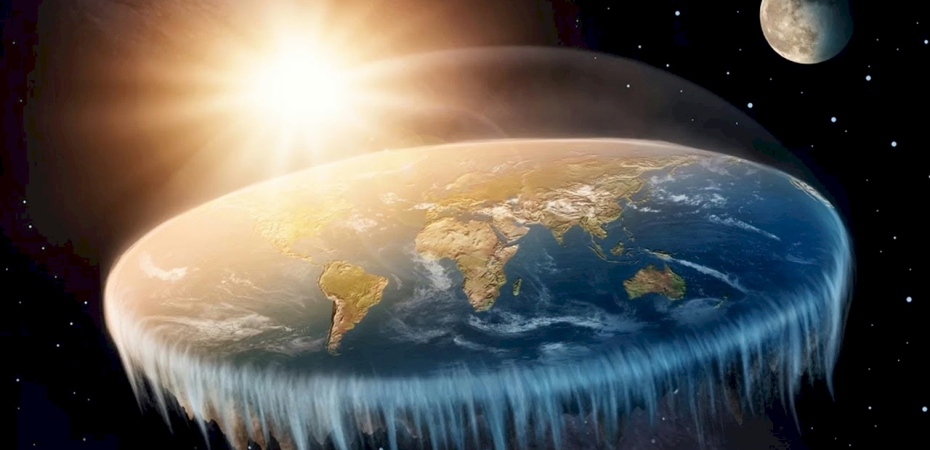

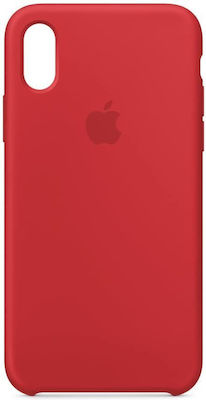

In [123]:
from io import BytesIO
import PIL
from IPython.display import display, Image

def display_img_array(ima):
    im = PIL.Image.fromarray(ima)
    bio = BytesIO()
    im.save(bio, format='png')
    display(Image(bio.getvalue(), format='png'))
    
def clustering(group,dataset_points):
    print("Cluster ",group)
    im = []
    for i in dataset_points:
        if(i.group == group):
            image = cv2.imread(i.filename)
            image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
            im.append(image)
    for ima in im:
        display_img_array(ima)
first_cluster = clustering(0,dataset_points)

Cluster  1


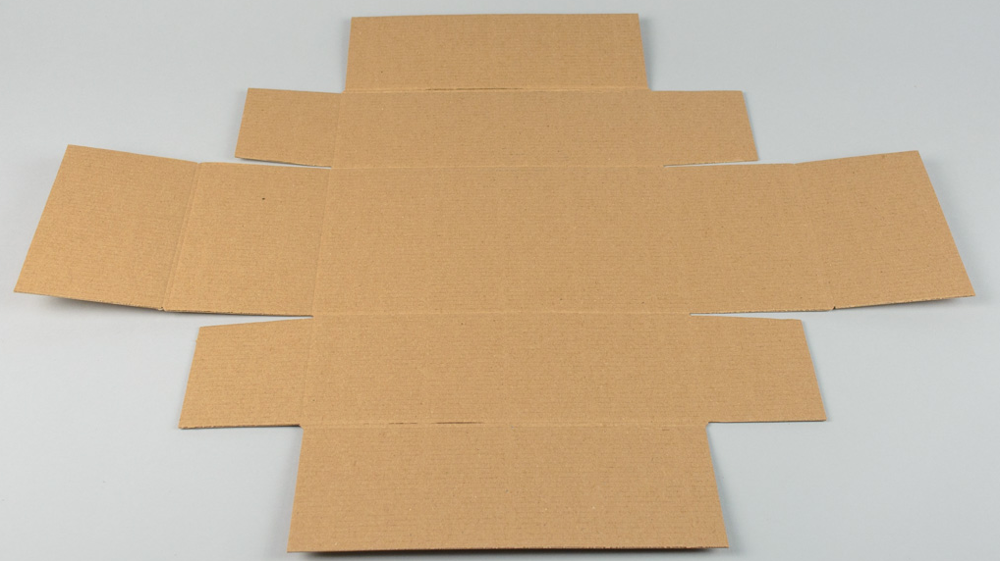

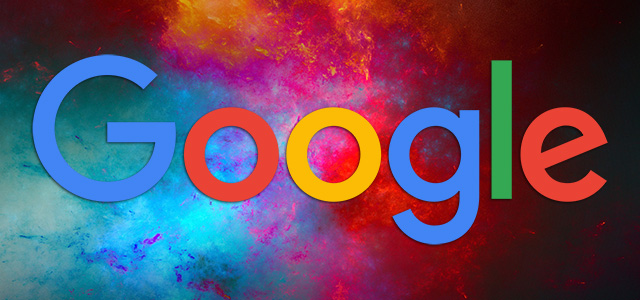

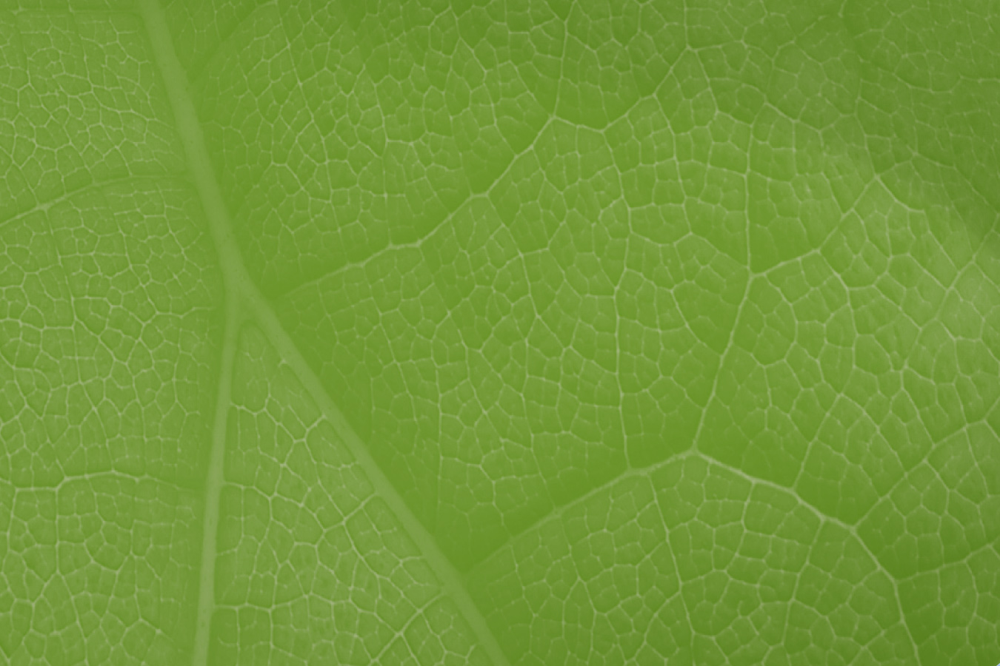

In [124]:
second_cluster = clustering(1,dataset_points)

Cluster  2


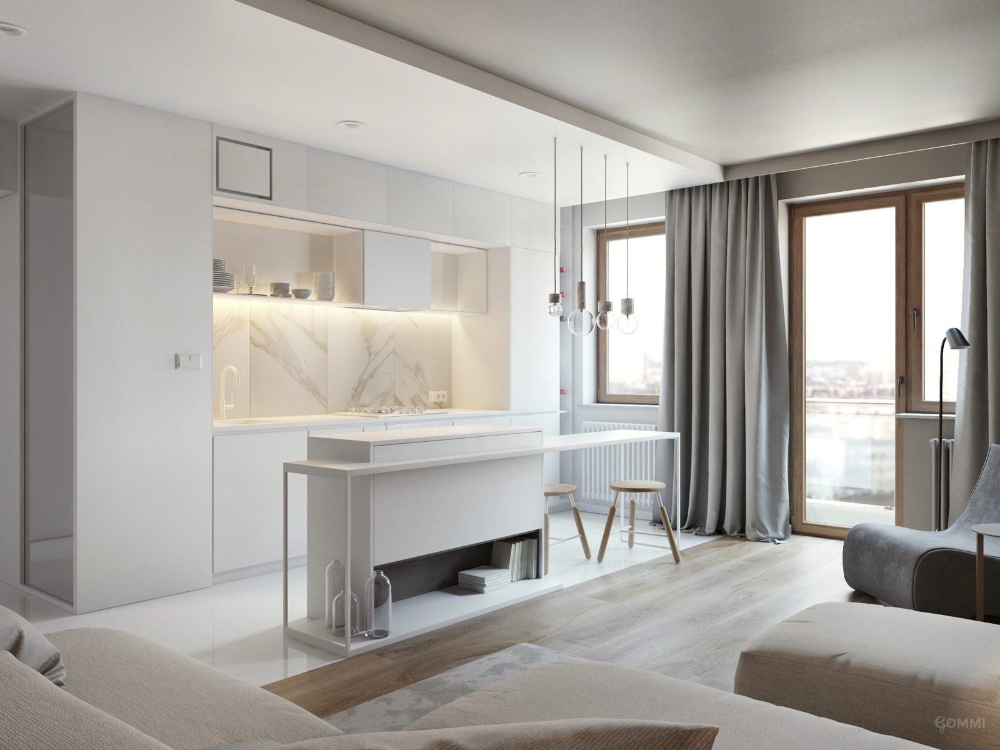

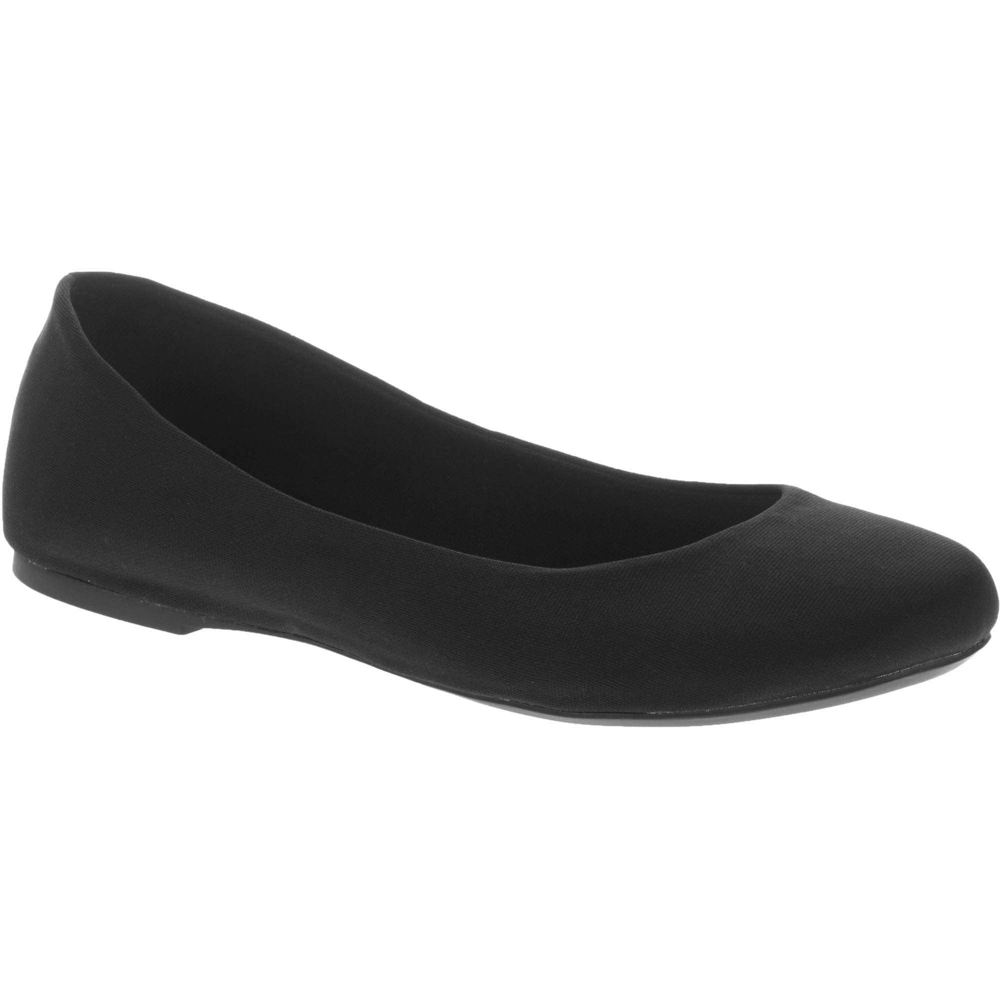

In [125]:
third_cluster = clustering(2,dataset_points)

# Clustering based on mean color

In [126]:
def feature_vectors_bgr(path):
    image = cv2.imread(path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    means = cv2.mean(image)
    means = means[:3]
    list_means = list(means)
    return list_means
vec = feature_vectors_bgr(paths[4])
vec

[197.7917233009709, 68.01105582524272, 73.25940533980582]

In [127]:
datapoints = []
for image in paths:
    features = feature_vectors_bgr(image)
    temp_object = Dataset(image,features)
    temp_object.printObject()
    datapoints.append(temp_object)

Image Name:  C:/Users/GNR/Desktop/Project_Comp_Geometry/carton.png
Feature vector: 
[199.76262759833486, 177.6706692129089, 149.5496087900312]
Image Name:  C:/Users/GNR/Desktop/Project_Comp_Geometry/flatearth.png
Feature vector: 
[93.88836798088411, 89.8081266427718, 83.83870489844684]
Image Name:  C:/Users/GNR/Desktop/Project_Comp_Geometry/flat01.png
Feature vector: 
[167.72896458333335, 164.35064427083333, 159.1908875]
Image Name:  C:/Users/GNR/Downloads/google.png
Feature vector: 
[98.00981770833333, 72.529921875, 94.231484375]
Image Name:  C:/Users/GNR/Downloads/red.png
Feature vector: 
[197.7917233009709, 68.01105582524272, 73.25940533980582]
Image Name:  C:/Users/GNR/Downloads/priorities-landing-page.png
Feature vector: 
[115.07885349794239, 151.9267267489712, 57.04897613168725]
Image Name:  C:/Users/GNR/Downloads/flats.png
Feature vector: 
[201.19779574999998, 201.19779574999998, 201.19779574999998]


In [128]:
true_dim_bgr = max(node.dim for node in datapoints)
true_dim_bgr

3

In [129]:
final_clusters_bgr = my_kmeans(datapoints,k,true_dim_bgr)
final_clusters_bgr

[-2.9253256673006645, 0.9800171410673535, -4.421396091349195]
0
[4.393229724553686, -0.6312617085956624, 7.885020044265779]
1
[6.645860636373559, 6.197461239596834, -2.2904301361110253]
2
C:/Users/GNR/Desktop/Project_Comp_Geometry/carton.png
For one point distances:  309.85329314494476
For one point distances:  300.04938910187377
For one point distances:  299.58728970967974
C:/Users/GNR/Desktop/Project_Comp_Geometry/flatearth.png
For one point distances:  158.2819311929835
For one point distances:  148.18105472636307
For one point distances:  148.392137118918
C:/Users/GNR/Desktop/Project_Comp_Geometry/flat01.png
For one point distances:  287.3705411688831
For one point distances:  277.11199380213577
For one point distances:  277.5543399509246
C:/Users/GNR/Downloads/google.png
For one point distances:  158.23932147226367
For one point distances:  146.87524036234322
For one point distances:  148.53904525977148
C:/Users/GNR/Downloads/red.png
For one point distances:  225.4213849762206
For

[[],

In [130]:
for i in range(0,len(final_clusters_bgr)):
    for j in final_clusters_bgr[i]:
        j.clusterGroup(i)
for d in datapoints:
    print("Image title: ", d.filename)
    print("Image cluster: ", d.group)

Image title:  C:/Users/GNR/Desktop/Project_Comp_Geometry/carton.png
Image cluster:  2
Image title:  C:/Users/GNR/Desktop/Project_Comp_Geometry/flatearth.png
Image cluster:  1
Image title:  C:/Users/GNR/Desktop/Project_Comp_Geometry/flat01.png
Image cluster:  1
Image title:  C:/Users/GNR/Downloads/google.png
Image cluster:  1
Image title:  C:/Users/GNR/Downloads/red.png
Image cluster:  2
Image title:  C:/Users/GNR/Downloads/priorities-landing-page.png
Image cluster:  2
Image title:  C:/Users/GNR/Downloads/flats.png
Image cluster:  1


In [131]:
first_cluster_ = clustering(0,datapoints)

Cluster  0


Cluster  1


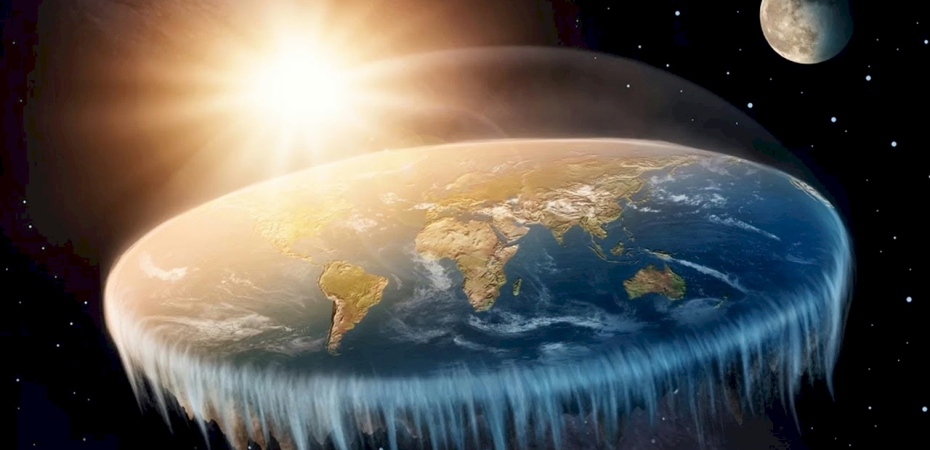

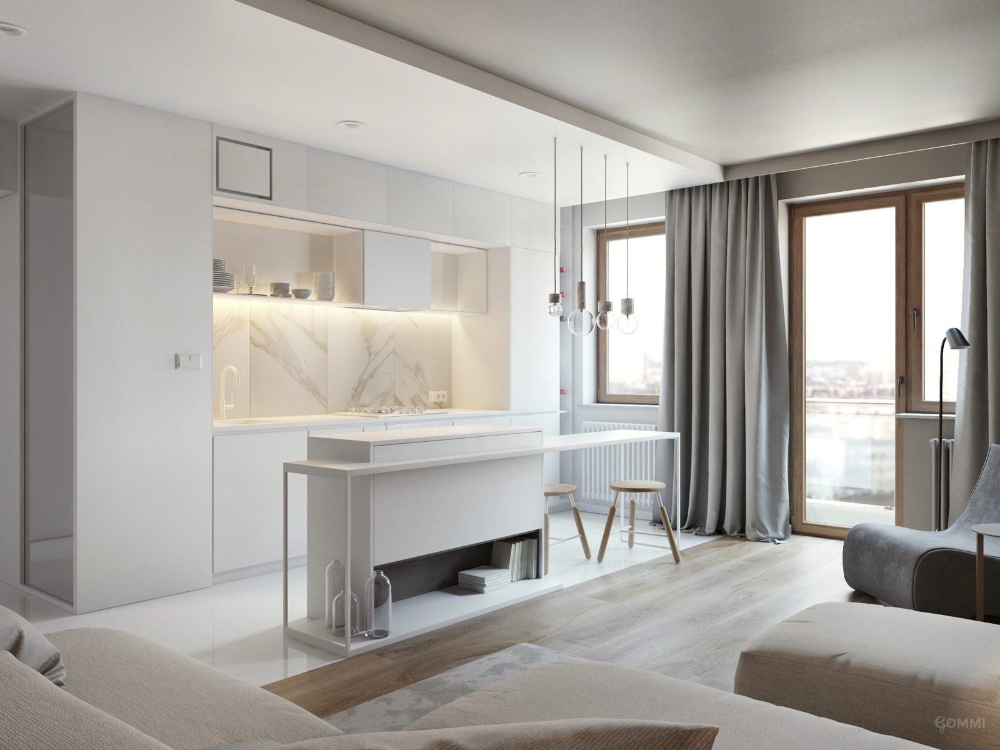

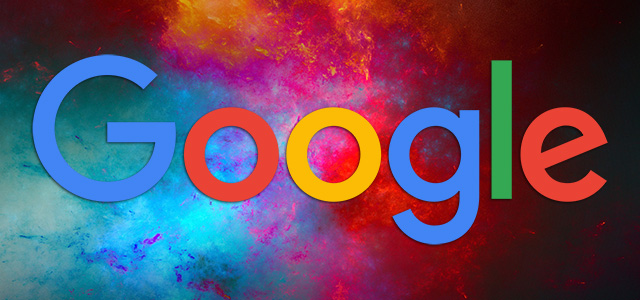

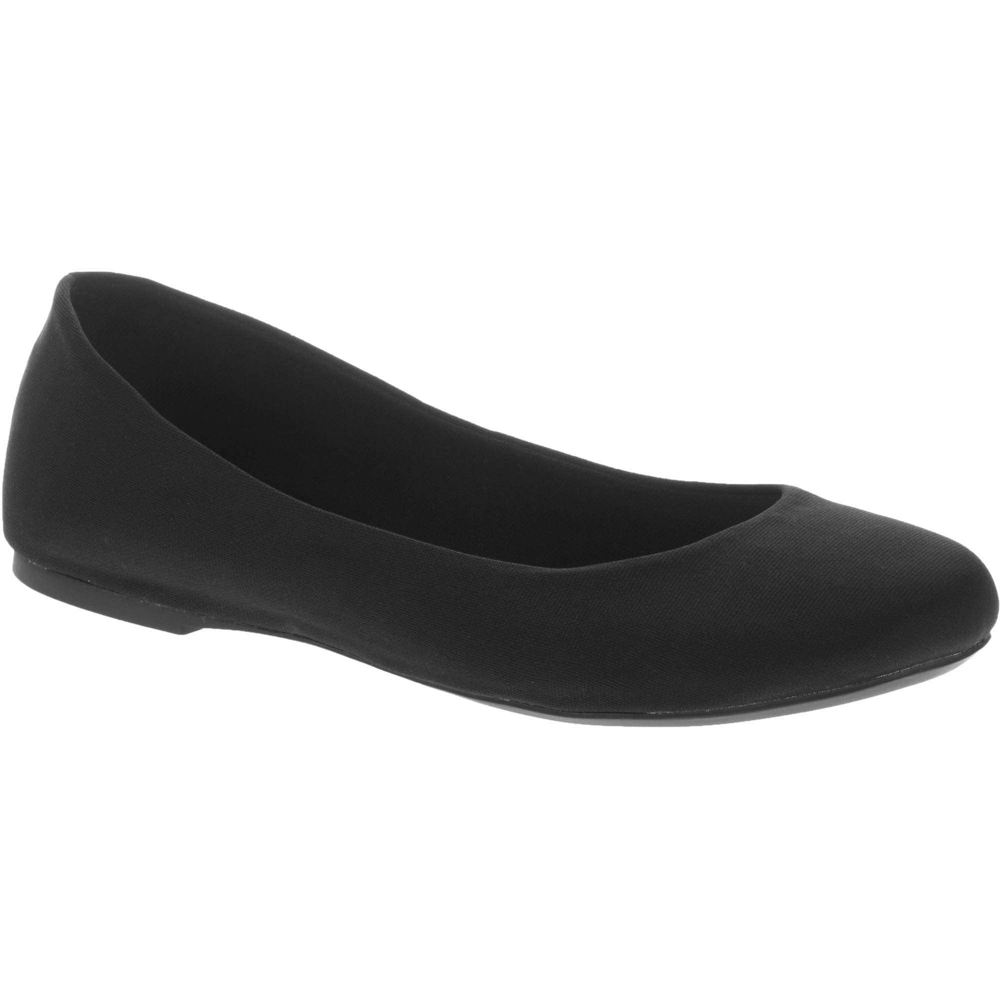

In [132]:
second_cluster_ = clustering(1,datapoints)

Cluster  2


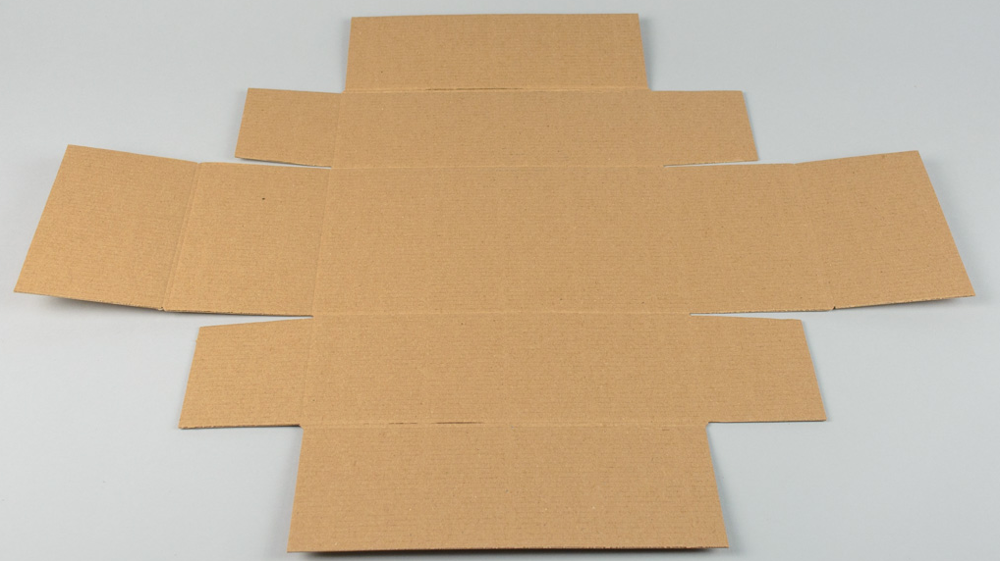

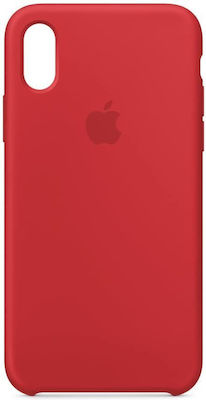

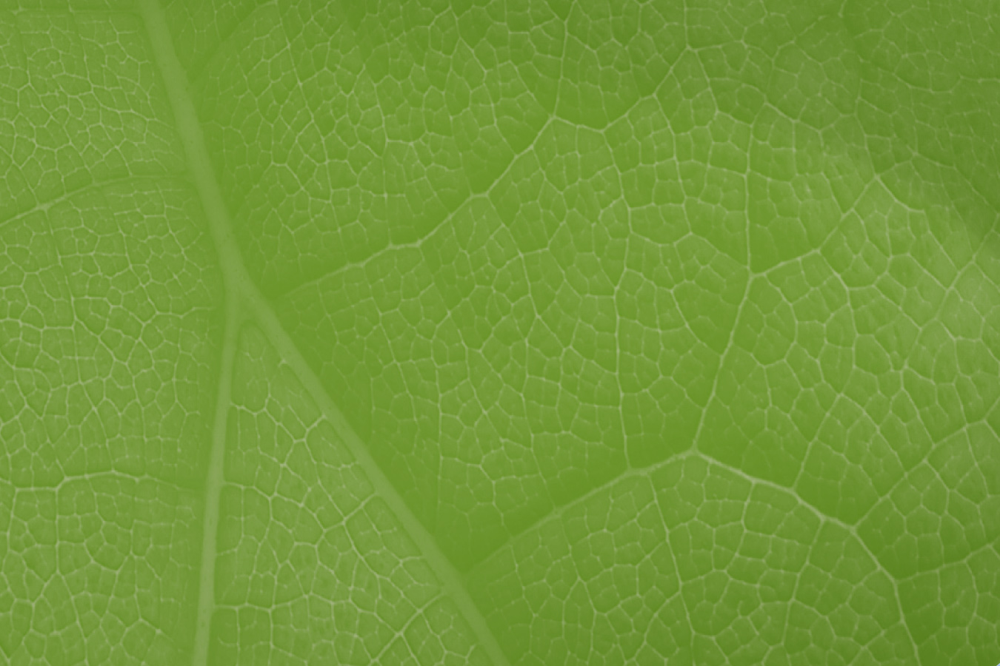

In [133]:
third_cluster_ = clustering(2,datapoints)

# Clustering  based on mean color using Sklearn K-Means

In [134]:
X = []
for d in datapoints:
    X.append(d.feature_vector)
X = np.array(X)
X

array([[199.7626276 , 177.67066921, 149.54960879],
       [ 93.88836798,  89.80812664,  83.8387049 ],
       [167.72896458, 164.35064427, 159.1908875 ],
       [ 98.00981771,  72.52992187,  94.23148437],
       [197.7917233 ,  68.01105583,  73.25940534],
       [115.0788535 , 151.92672675,  57.04897613],
       [201.19779575, 201.19779575, 201.19779575]])

In [135]:
kmeans = KMeans(n_clusters=3, random_state=0).fit(X)
k_labels1 = kmeans.labels_.tolist()
for i in range(0,len(datapoints)):
    datapoints[i].clusterGroup(k_labels1[i])

Cluster  0


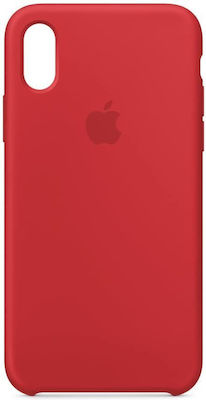

In [136]:
first_cluster_p = clustering(0,datapoints)

Cluster  1


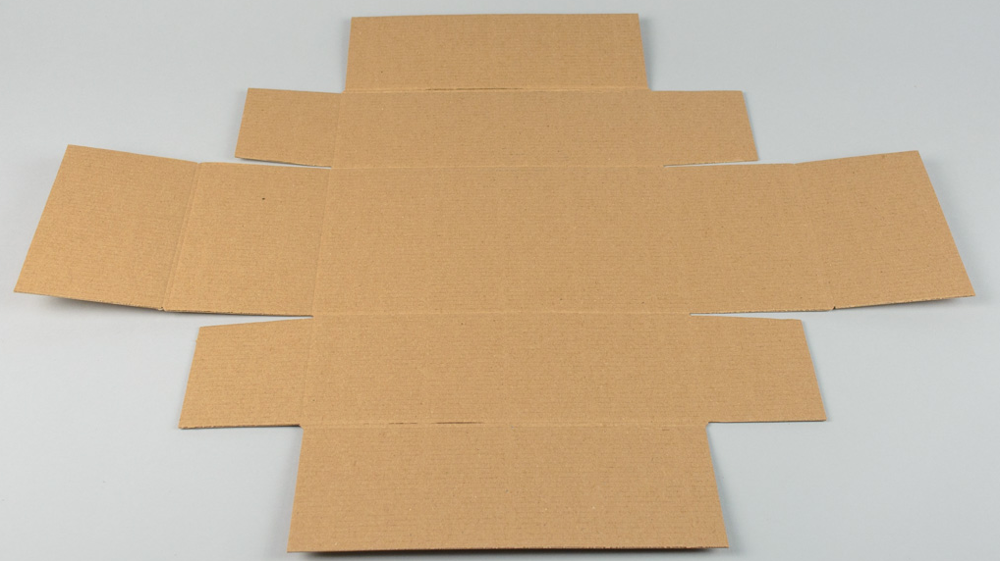

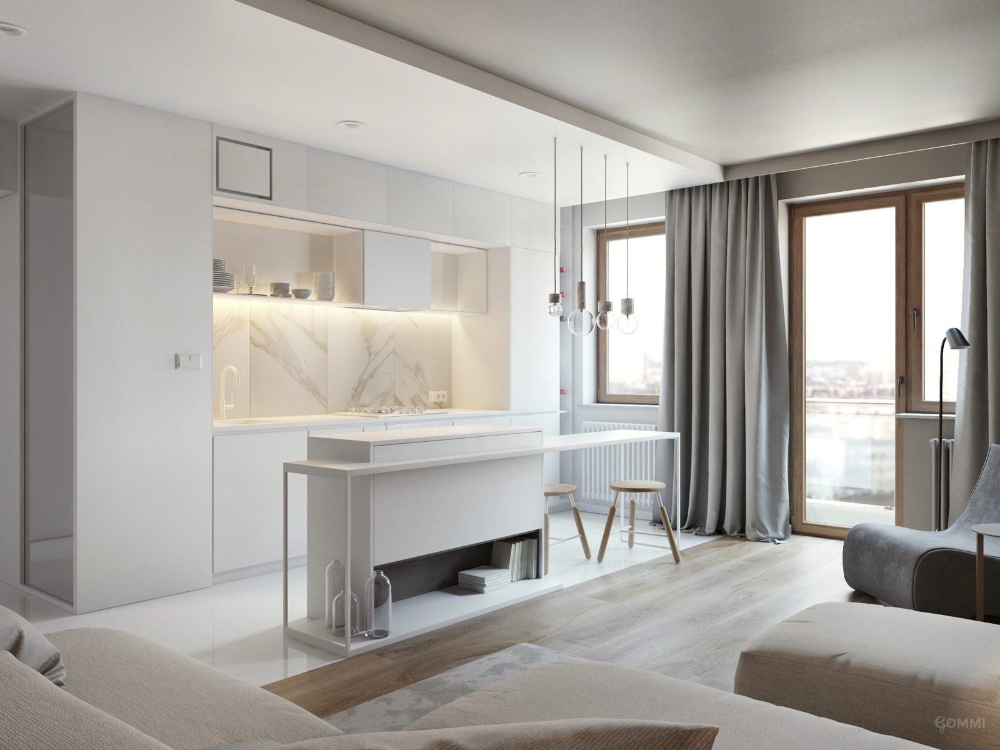

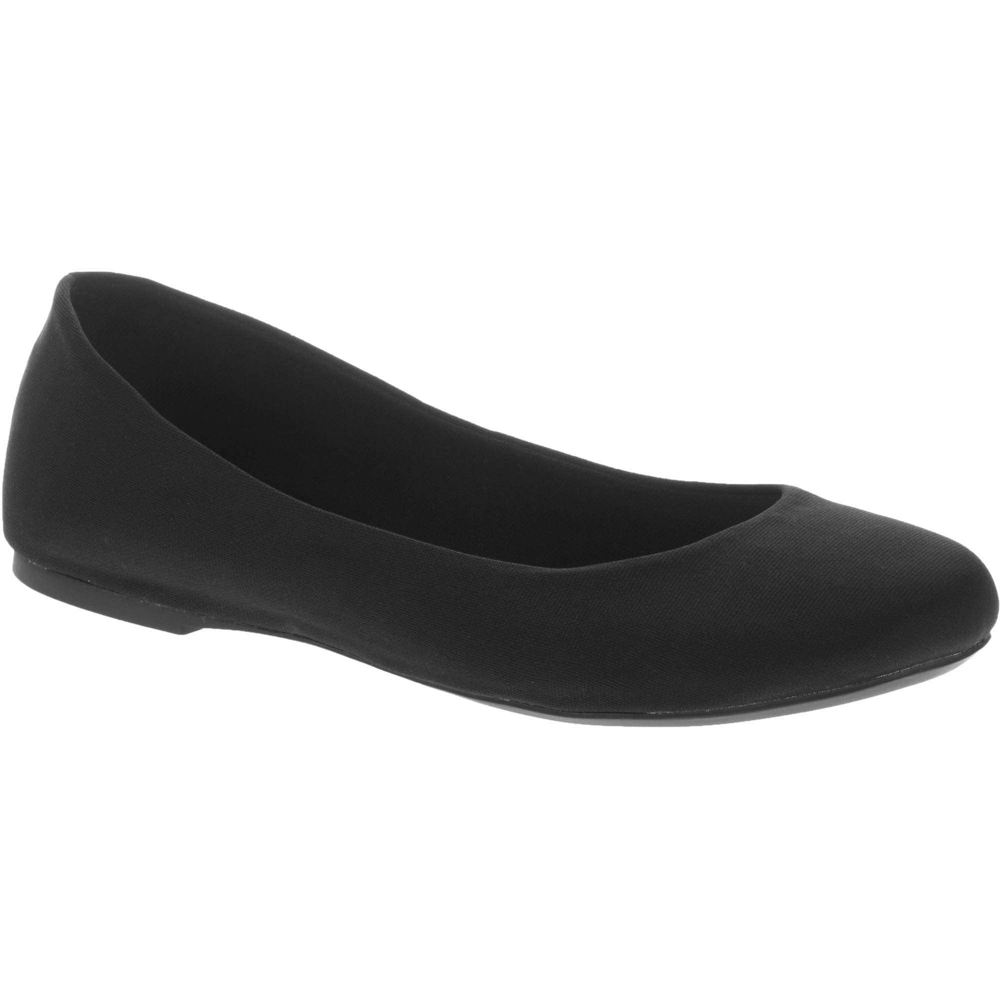

In [137]:
second_cluster_p = clustering(1,datapoints)

Cluster  2


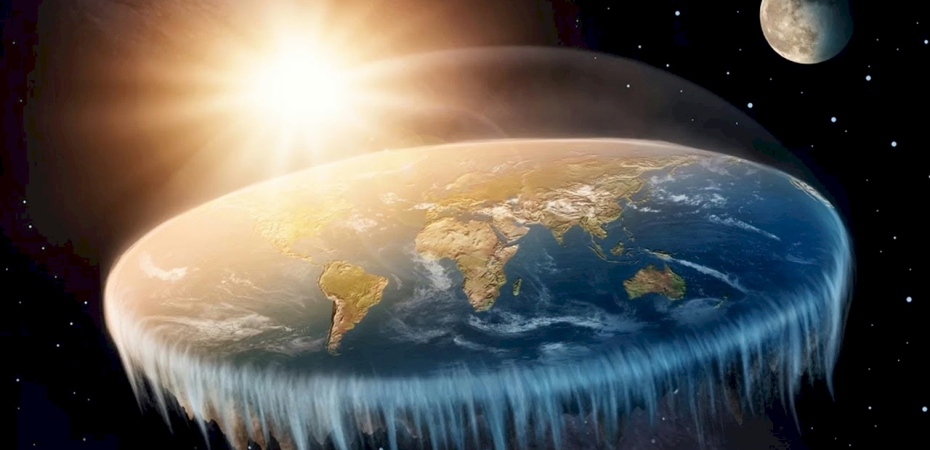

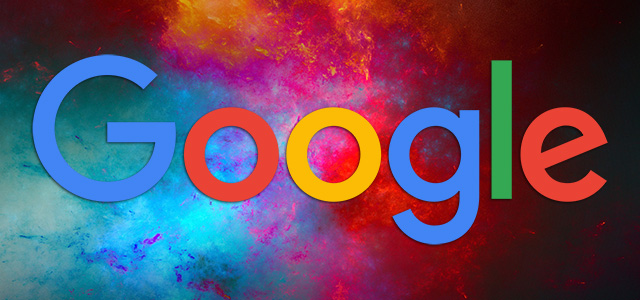

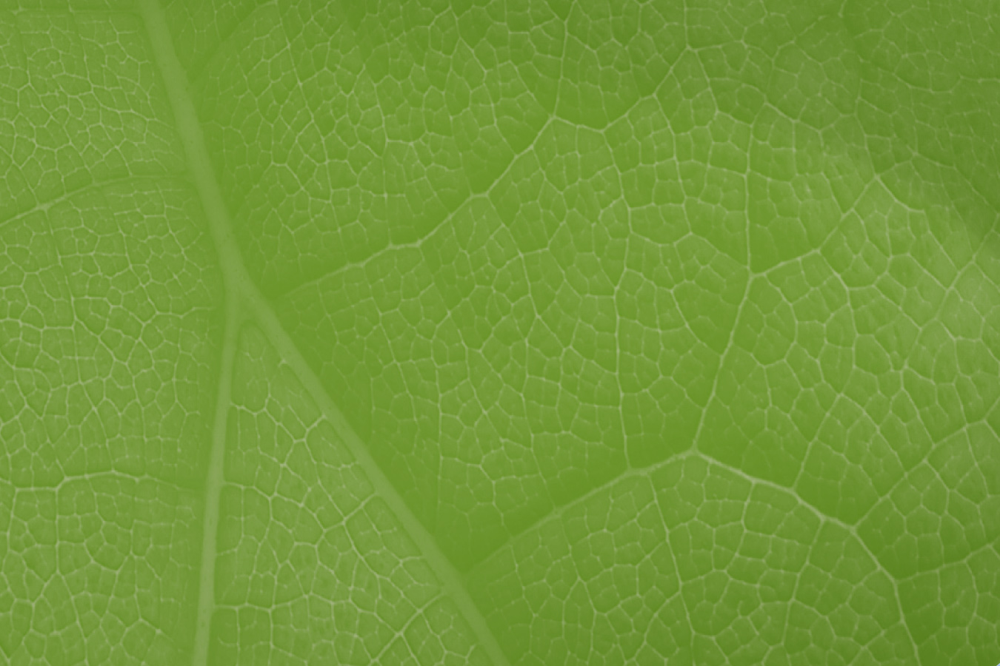

In [138]:
third_cluster_p = clustering(2,datapoints)

# Search by Image

(1909, 3000, 3)

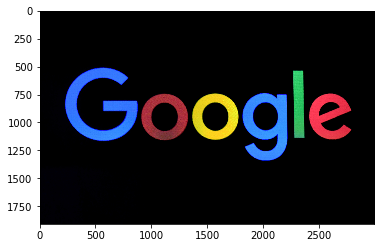

In [139]:
image_ = cv2.imread("goog.png")
image_ = cv2.cvtColor(image_, cv2.COLOR_BGR2RGB)
plt.imshow(image_)
image_.shape

In [140]:
vec_ = feature_vectors_bgr("goog.png")
vec_

[13.078852278679937, 13.432466736511262, 17.981390955124848]

In [141]:
arr = kmeans.predict([vec_])

Cluster  2


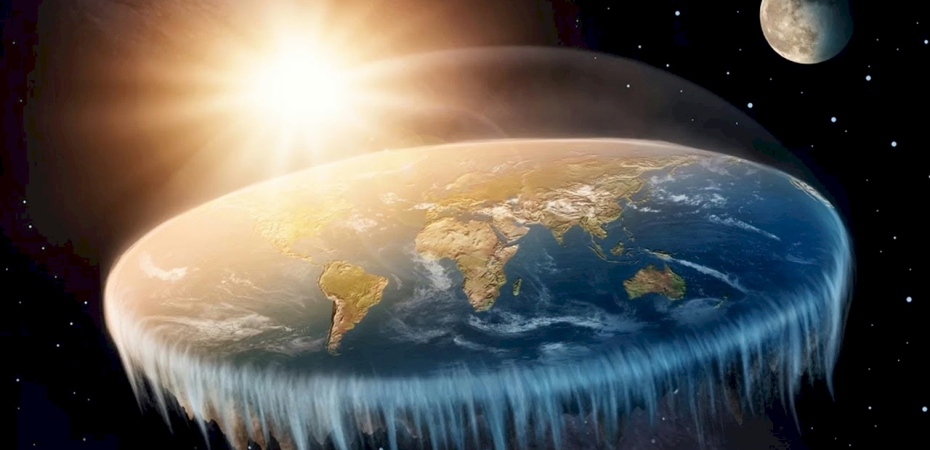

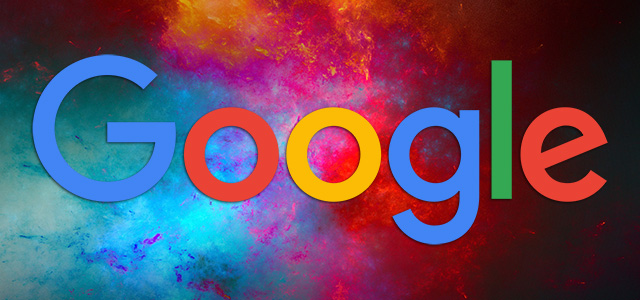

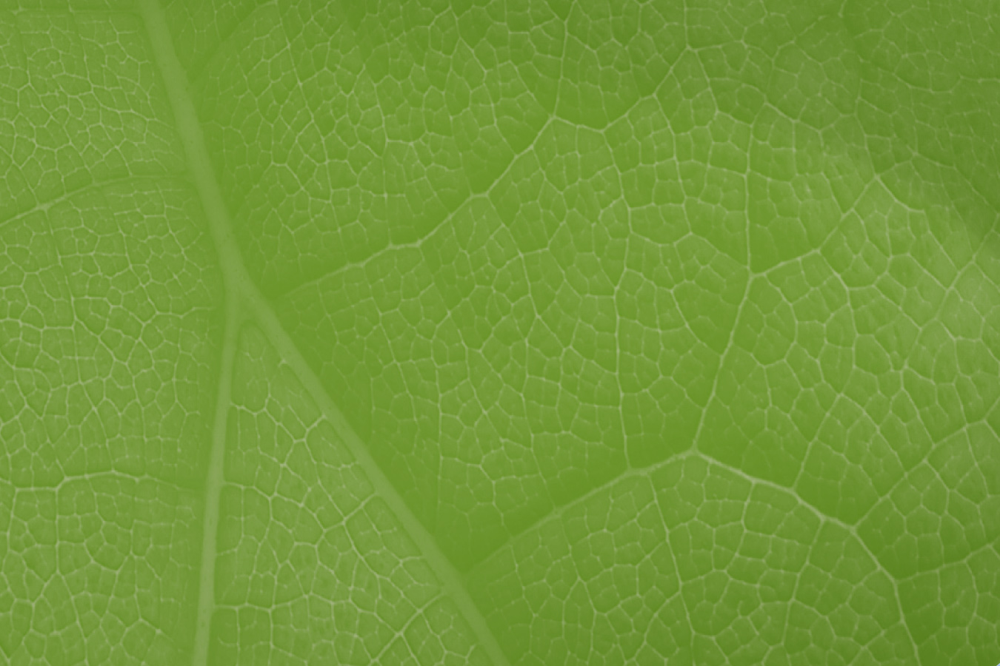

In [142]:
retrieve_images = clustering(arr[0],datapoints)

## Why do we have these results?
The mean colors of our query image are shown below:

In [143]:
# Swap blue and red values (making it RGB, not BGR)
observation = np.array([(vec_[2], vec_[1], vec_[0])])

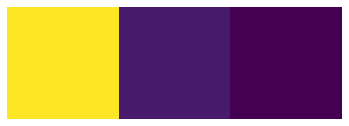

In [144]:
plt.imshow(observation), plt.axis("off")
plt.show()

## Grayscale Images [Feature Extractions]

In [145]:
def feature_matrix_grayscale(path):
    image = cv2.imread(path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    return image #return a matrix
feature_matrix_grayscale(paths[1]).shape

(450, 930)

In [146]:
gray_dataset_points = []

for image in paths:
    photo = feature_matrix_grayscale(image)
    features = flatten_image(photo)
    features = shape_features(features)
    temp_object = Dataset(image,features)
    temp_object.printObject()
    gray_dataset_points.append(temp_object)

Features Shape:  (582296,)
Image Name:  C:/Users/GNR/Desktop/Project_Comp_Geometry/carton.png
Feature vector: 
[203 204 203 ... 202 201 201]
Features Shape:  (418500,)
Image Name:  C:/Users/GNR/Desktop/Project_Comp_Geometry/flatearth.png
Feature vector: 
[3 2 2 ... 0 0 0]
Features Shape:  (1920000,)
Image Name:  C:/Users/GNR/Desktop/Project_Comp_Geometry/flat01.png
Feature vector: 
[169 171 171 ...  88  87  85]
Features Shape:  (192000,)
Image Name:  C:/Users/GNR/Downloads/google.png
Feature vector: 
[31 31 30 ... 15 15 18]
Features Shape:  (82400,)
Image Name:  C:/Users/GNR/Downloads/red.png
Feature vector: 
[255 255 255 ... 255 255 255]
Features Shape:  (1215000,)
Image Name:  C:/Users/GNR/Downloads/priorities-landing-page.png
Feature vector: 
[128 127 128 ... 191 182 178]
Features Shape:  (4000000,)
Image Name:  C:/Users/GNR/Downloads/flats.png
Feature vector: 
[255 255 255 ... 255 255 255]


In [147]:
true_dim = max(node.dim for node in gray_dataset_points) 
for point in gray_dataset_points:
    point.updatedDataset(true_dim)
X = []
for d in gray_dataset_points:
    X.append(d.feature_vector)
X = np.array(X)
X

array([[203., 204., 203., ...,   0.,   0.,   0.],
       [  3.,   2.,   2., ...,   0.,   0.,   0.],
       [169., 171., 171., ...,   0.,   0.,   0.],
       ...,
       [255., 255., 255., ...,   0.,   0.,   0.],
       [128., 127., 128., ...,   0.,   0.,   0.],
       [255., 255., 255., ..., 255., 255., 255.]])

In [148]:
kmeans = KMeans(n_clusters=3, random_state=0).fit(X)
k_labels1 = kmeans.labels_.tolist()
for i in range(0,len(gray_dataset_points)):
    gray_dataset_points[i].clusterGroup(k_labels1[i])

Cluster  0


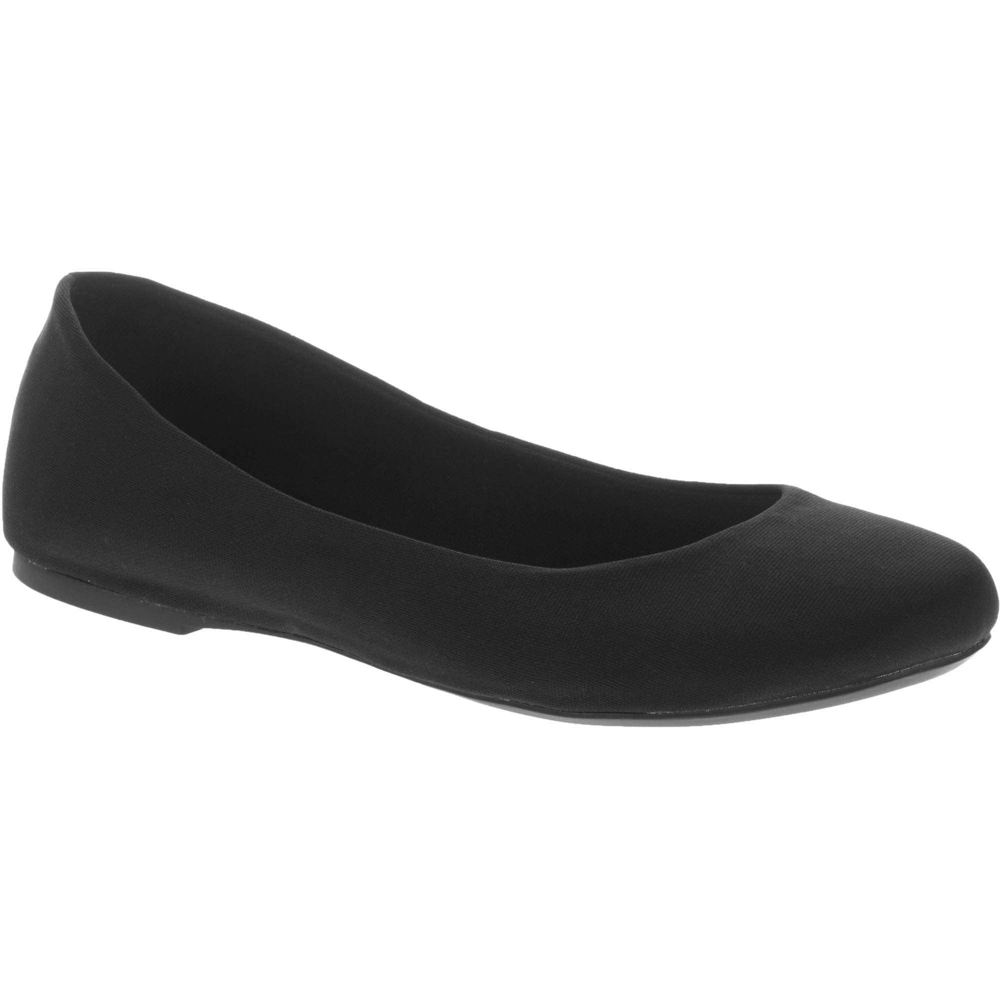

In [149]:
first_cluster_p = clustering(0, gray_dataset_points)

Cluster  1


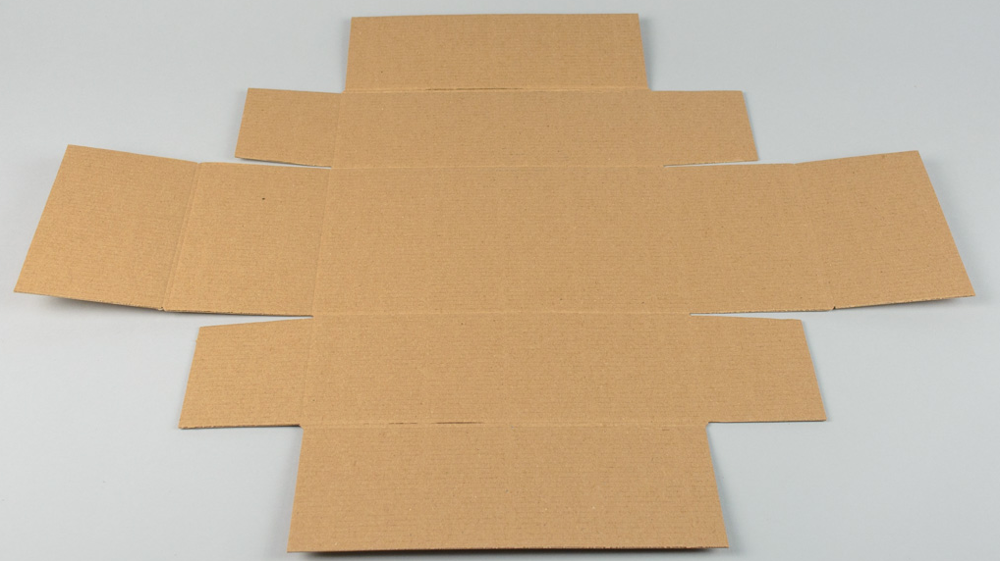

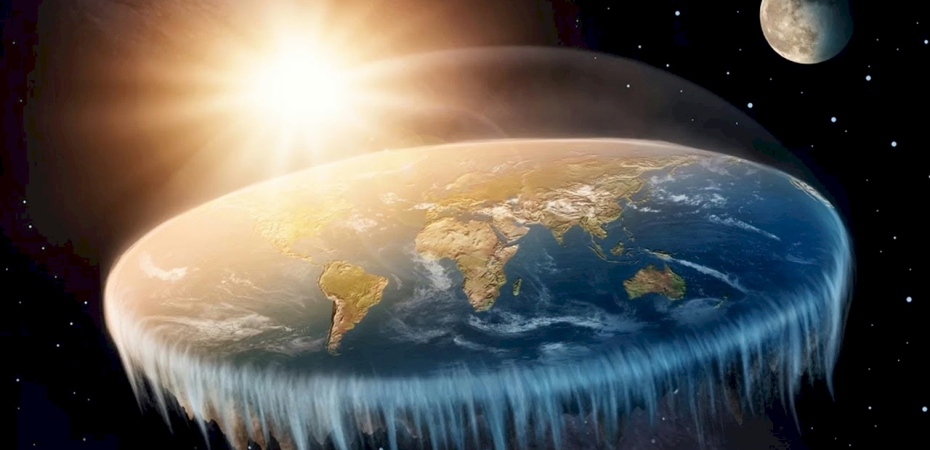

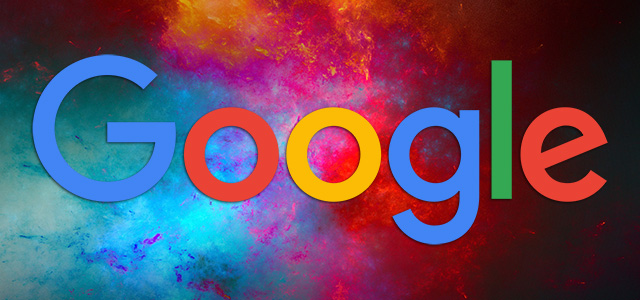

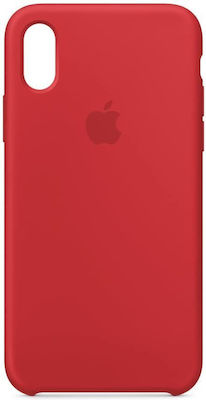

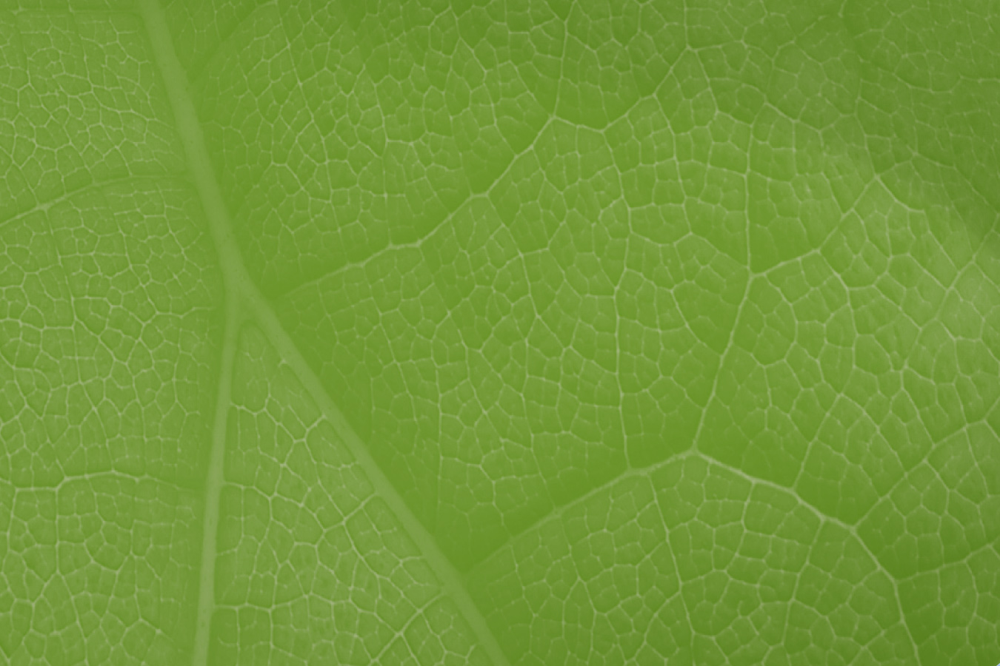

In [150]:
sec_cluster_p = clustering(1, gray_dataset_points)

Cluster  2


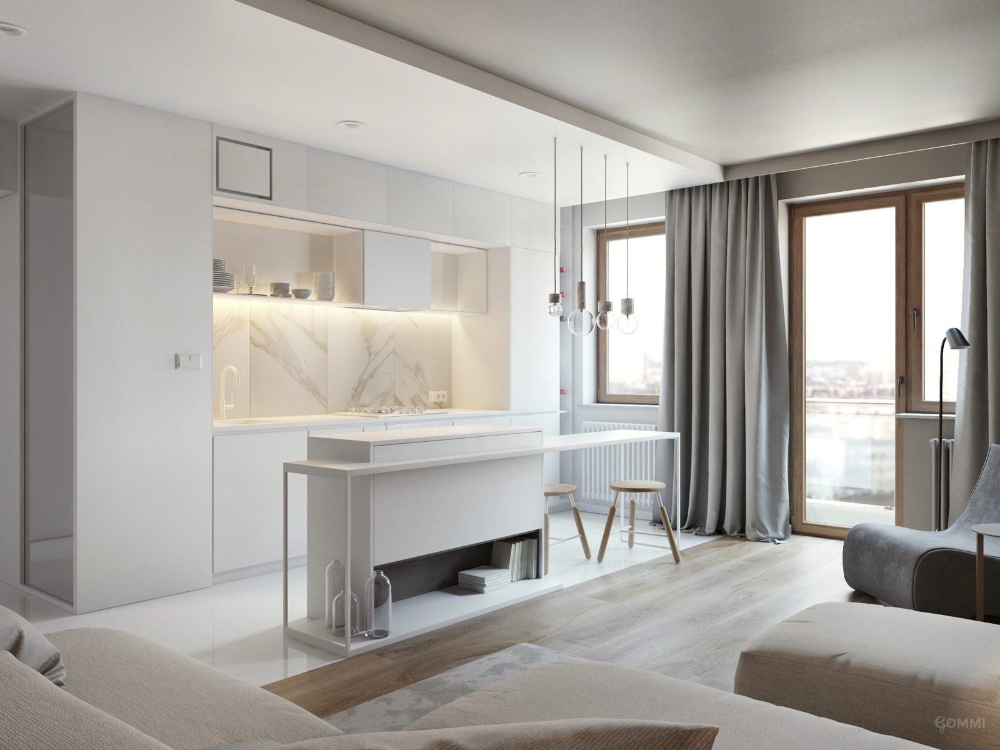

In [151]:
third_cluster_p = clustering(2, gray_dataset_points)